In [1]:
DATASET = "COVID19_2023_02_22.csv"

REBUILD_DATASET = False

In [2]:
if REBUILD_DATASET:

    import csv
    from tqdm import tqdm

    # Print columns names
    with open(DATA_SOURCE, 'r', encoding="utf-8") as csv_src:
        header = next(csv_src).split(sep=',')
        for n, col in enumerate(header):
            print(n, ":", col)

    DATA_SOURCE = "tweets_processed_merged_users_2023_02_22.csv"

    # Set this to limit the target number of CSV rows to process.
    # Set to None to process all rows
    ROWS_LIMIT = None #500_000 #300_000
    

    # Initialize statistics
    MONITOR = {"processed_tweets_count": 0,
               "fixed_tweets_count": 0,
               "broken_tweets": [],
               "fixed_tweets": []}
    
    # Open two file streams at the same time: source and destination
    with (open(DATA_SOURCE, 'r', encoding="utf-8") as csv_src, open(DATASET, 'w', encoding="utf-8") as csv_dst):
              
        csv_reader = csv.reader(csv_src, delimiter=',', lineterminator='\n')
        csv_writer = csv.writer(csv_dst, delimiter=',', lineterminator='\n')
    
        row_buffer = []
        
        for n, row in tqdm(enumerate(csv_reader)):
    
            if n == 0:
                # Determine number of columns
                ncols = len(row)
            
                # Write the header in the dest file
                csv_writer.writerow(row)       
        
            elif not ROWS_LIMIT or n <= ROWS_LIMIT:
    
                # Counter for stats
                MONITOR["processed_tweets_count"] += 1
                
                # Check if values mismatch
                if len(row) != ncols:

                    MONITOR["broken_tweets"].append(','.join(row))
        
                    # Fix broken row point
                    prev_last_token = "" if len(row_buffer) == 0 else row_buffer.pop() 
                    next_first_token = "" if len(row) == 0 else row.pop(0)
                    fixed_token = prev_last_token + next_first_token
                    row_buffer.append(fixed_token)
                    row_buffer += row
        
                    # Check if the row is completely fixed
                    if len(row_buffer) == ncols:
                        
                        MONITOR["fixed_tweets_count"] += 1
                        MONITOR["fixed_tweets"].append(','.join(row_buffer))
                        
                        row = row_buffer
                        row_buffer = [] # Reset the row buffer for next broken rows
                        
                    else:
                        
                        continue # Skip current iteration
        
                # Write the row in the destination file
                row = [token.replace('\n', "<return>") for token in row]
                csv_writer.writerow(row)
        
            else:
                
                break # When ROWS_LIMIT is not None this will stop the reading loop

    print(f"Processed {MONITOR['processed_tweets_count']} tweets, fixed: {MONITOR['fixed_tweets_count']}")

In [3]:
import re

def extract_domains(input_string):
    pattern = r"(?:(?:https?://www\.)|(?:https?://)|(?:www\.))([\w.-]+\.\w{2,})(?:(?:/)|(?: )|(?:;))?"
    matches = re.findall(pattern, input_string)
    return matches

# Example usage:
input_string = "Check out https://www.example.com; and http://another-example.org for more info."
result = extract_domains(input_string)
print(result)


['example.com', 'another-example.org']


In [4]:
import re

def extract_urls(input_string):
    pattern = r"(https?://(?:www\.)?[\w.-]+\.\w{2,}(?:[^\s]*)?)"
    matches = re.findall(pattern, input_string)
    return matches

# Example usage:
input_string = "Check out https://www.exampl;e.com/path1; and http://another-example.org/path2 for more info."
result = extract_urls(input_string)
print(result)


['https://www.exampl;e.com/path1;', 'http://another-example.org/path2']


In [5]:
import pandas as pd

# use_cols = ["tweet_id", "created_at", "user_id", "is_original", "is_retweet", "is_reply", "is_quote", "urls"]
use_cols = ["tweet_id", "user_id", "urls"]

df_a = pd.read_csv("COVID19_2023_02_22.csv", nrows=100, usecols=use_cols)
extract_domains(df_a["urls"].dropna().iloc[16])

['repubblica.it', 'tweetedtimes.com']

In [6]:
newsguard_cols = ["identifier", "identifierAlt", "score"]
df_b = pd.read_csv("newsguard_ratings.csv", usecols=newsguard_cols)

In [7]:
import dask.dataframe as dd

use_cols = ["tweet_id", "created_at", "user_id", "is_original", "is_retweet", "is_reply", "is_quote"]

ddf = dd.read_csv("COVID19_2023_02_22.csv", usecols=use_cols, on_bad_lines="skip", lineterminator='\n')

In [8]:
ddf['created_at'] = dd.to_datetime(ddf['created_at'])#, errors='coerce')

In [9]:
# ddf = ddf.loc[(ddf.is_original == 1) | (ddf.is_retweet == 1)]

In [10]:
# Display the resulting DataFrame
# ddf.compute()

In [11]:
# Users behavior (tweets vs retweets) dataframe

# Group by 'user_id' and aggregate the counts
behavior_ddf = ddf.groupby('user_id').agg({'is_original': 'sum',
                                           'is_retweet': 'sum',
                                           'is_reply': 'sum',
                                           'is_quote': 'sum'}).reset_index()

# Rename columns for clarity
behavior_ddf = behavior_ddf.rename(columns={'is_original': 'total_tweets',
                                            'is_retweet': 'total_retweets',
                                            'is_reply': 'total_replies',
                                            'is_quote': 'total_quotes'})

# If you want to fill NaN values in 'total_retweets' column (in case there are no retweets for a user)
behavior_ddf = behavior_ddf.fillna(0)

# Adding replies and quotes
behavior_ddf["total_transform"] = behavior_ddf["total_replies"] + behavior_ddf["total_quotes"]
#behavior_ddf["total_tweets"] += behavior_ddf["total_mixed"]
#behavior_ddf["total_retweets"] += behavior_ddf["total_mixed"]

In [12]:
# Display the resulting DataFrame
# result_df.compute()

In [13]:
# import dask.dataframe as dd
from dask_ml.preprocessing import RobustScaler, MinMaxScaler

# Select the columns you want to scale
columns_to_scale = ["total_tweets", "total_retweets", "total_transform"]

# Instantiate the RobustScaler
scaler = RobustScaler() # MinMaxScaler() #

# Fit the scaler on the Dask DataFrame
scaler.fit(behavior_ddf[columns_to_scale])

# Transform the selected columns using the fitted scaler
scaled_ddf = scaler.transform(behavior_ddf[columns_to_scale])

# Replace the count with scaled values
behavior_ddf.total_tweets = scaled_ddf.total_tweets
behavior_ddf.total_retweets = scaled_ddf.total_retweets
behavior_ddf.total_transform = scaled_ddf.total_transform

In [14]:
behavior_ddf = behavior_ddf.compute()
behavior_ddf

,user_id,total_tweets,total_retweets,total_replies,total_quotes,total_transform
0,398032197,23.0,1122.5,154,589,371.0
1,1038231816,0.0,125.5,0,4,1.5
2,457762156,33.0,220.5,2,141,71.0
3,1312802310830125057,1.0,1802.0,9,707,357.5
4,1030696837748060160,2.0,12.5,0,0,-0.5
...,...,...,...,...,...,...
542890,1444401005630742528,0.0,0.0,0,0,-0.5
542891,1354087175768444928,0.0,-0.5,0,1,0.0
542892,1451149300512215049,0.0,0.0,0,0,-0.5
542893,1448734413957763073,0.0,0.0,0,0,-0.5


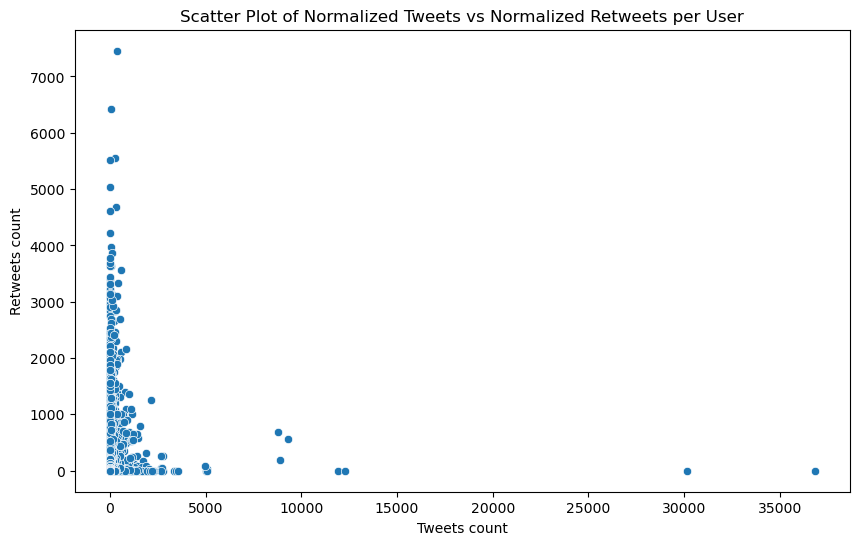

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
# import dask.dataframe as dd

# Assuming 'ddf' is your Dask DataFrame
# Convert 'created_at' to datetime if it's not already
# ddf['created_at'] = dd.to_datetime(ddf['created_at'], errors='coerce')

# Group by 'user_id' and aggregate the counts
#result_df = ddf.groupby('user_id').agg({'is_original': 'sum', 'is_retweet': 'sum'}).reset_index()

# If you want to fill NaN values in 'is_retweet' column (in case there are no retweets for a user)
#result_df['is_retweet'] = result_df['is_retweet'].fillna(0)

# Normalize counts if needed
#result_df['normalized_tweets'] = result_df['total_tweets'] / result_df['total_tweets'].sum()
#result_df['normalized_retweets'] = result_df['total_retweets'] / result_df['total_retweets'].sum()

# Scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='total_tweets', y='total_retweets', data=behavior_ddf)
plt.title('Scatter Plot of Normalized Tweets vs Normalized Retweets per User')
plt.xlabel('Tweets count')
plt.ylabel('Retweets count')
plt.show()

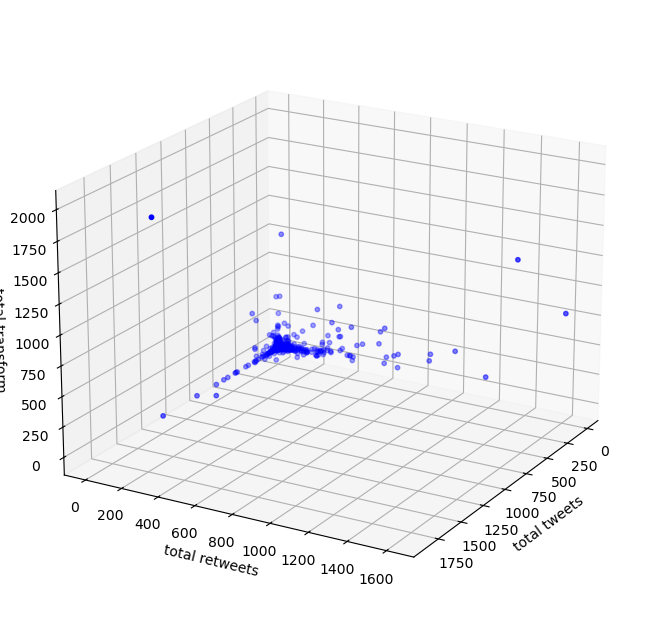

In [16]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
from matplotlib.animation import FuncAnimation
import numpy as np

def plot_3d_scatter(df, x_col, y_col, z_col, size=100, color='blue', rotation=None, title='3D Scatter Plot', gif_filename=None, subset_size=None):
    """
    Plot a 3D scatter plot.

    Parameters:
    - df: DataFrame, the input data.
    - x_col, y_col, z_col: str, column names for x, y, and z axes.
    - size: int, marker size (default is 100).
    - color: str, marker color (default is 'blue').
    - rotation: tuple, tuple of azimuthal and elevation angles for plot rotation (default is None).
    - title: str, plot title (default is '3D Scatter Plot').
    - gif_filename: str, filename to save the rotating GIF animation (default is None).
    - subset_size: int, size of the random subset to use for visualization (default is None, meaning use the entire dataset).

    Returns:
    - None (displays the plot or saves the GIF animation).
    """

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Use a subset of data if specified
    if subset_size is not None and subset_size < len(df):
        df_subset = df.sample(subset_size, random_state=42)
    else:
        df_subset = df

    # Scatter plot
    scatter = ax.scatter(df_subset[x_col], df_subset[y_col], df_subset[z_col], c=color, marker='o', s=size)

    # Set labels
    ax.set_xlabel(x_col.replace('_', ' '))
    ax.set_ylabel(y_col.replace('_', ' '))
    ax.set_zlabel(z_col.replace('_', ' '))

    # Set title
    # ax.set_title(title)

    # Set rotation if provided
    if rotation:
        ax.view_init(elev=rotation[0], azim=rotation[1])

    # Function to update plot for animation
    def update(frame):
        ax.view_init(elev=rotation[0], azim=rotation[1] + frame)
    
    # Generate rotating GIF animation if filename provided
    if gif_filename:
        ani = FuncAnimation(fig, update, frames=range(0, 360, 1), interval=50)
        ani.save(gif_filename, writer='imagemagick', fps=10)
    else:
        # Show plot
        plt.show()

# Example usage
# Assuming 'df' is your DataFrame with 500000+ points
# You can adjust the subset_size parameter to control the number of points used for visualization
plot_3d_scatter(behavior_ddf,
                'total_tweets',
                'total_retweets',
                'total_transform',
                size=10,
                color='blue',
                rotation=(20, 30),
                #title='Custom 3D Scatter Plot',
                gif_filename='rotation_animation_no_heat.gif',
                subset_size=10000)


In [17]:
#from IPython.display import Image
#with open('rotation_animation.gif','rb') as f:
 #   display(Image(data=f.read(), format='png'))

In [21]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
import pandas as pd
from matplotlib import cm

def plot_3d(df,
            x_col,
            y_col,
            z_col,
            colormap='viridis',
            size=100,
            title='3D Colored Scatter Plot',
            gif_filename=None,
            subset_size=1000):
    
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Use a subset of data if specified
    if subset_size is not None and subset_size < len(df):
        df_subset = df.sample(subset_size, random_state=42)
    else:
        df_subset = df

    # Scatter plot with a color map
    scatter = ax.scatter(df_subset[x_col],
                         df_subset[y_col],
                         df_subset[z_col],
                         c=df_subset[z_col],
                         cmap=colormap,
                         marker='o',
                         s=size)

    # Set labels
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_zlabel(z_col)

    # Set title
    ax.set_title(title)

    # Add color bar
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label(z_col)

    # Function to update plot for animation
    def update(frame):
        ax.view_init(elev=20, azim=frame)

    # Generate rotating GIF animation if filename provided
    if gif_filename:
        ani = FuncAnimation(fig, update, frames=range(0, 360, 1), interval=10)
        ani.save(gif_filename, writer='imagemagick', fps=30)# fps=30)
        plt.close(fig)  # To prevent the animation from displaying in the notebook

    plt.show()


# Use a color map (viridis in this case) and create the animated scatter plot with a subset of data
plot_3d(behavior_ddf,
          'total_tweets',
          'total_retweets',
          'total_mixed',
          colormap='viridis',
          size=10,
          title='3D Colored Scatter Plot Animation',
          gif_filename='rotation_animation_colored.gif',
          subset_size=10000)

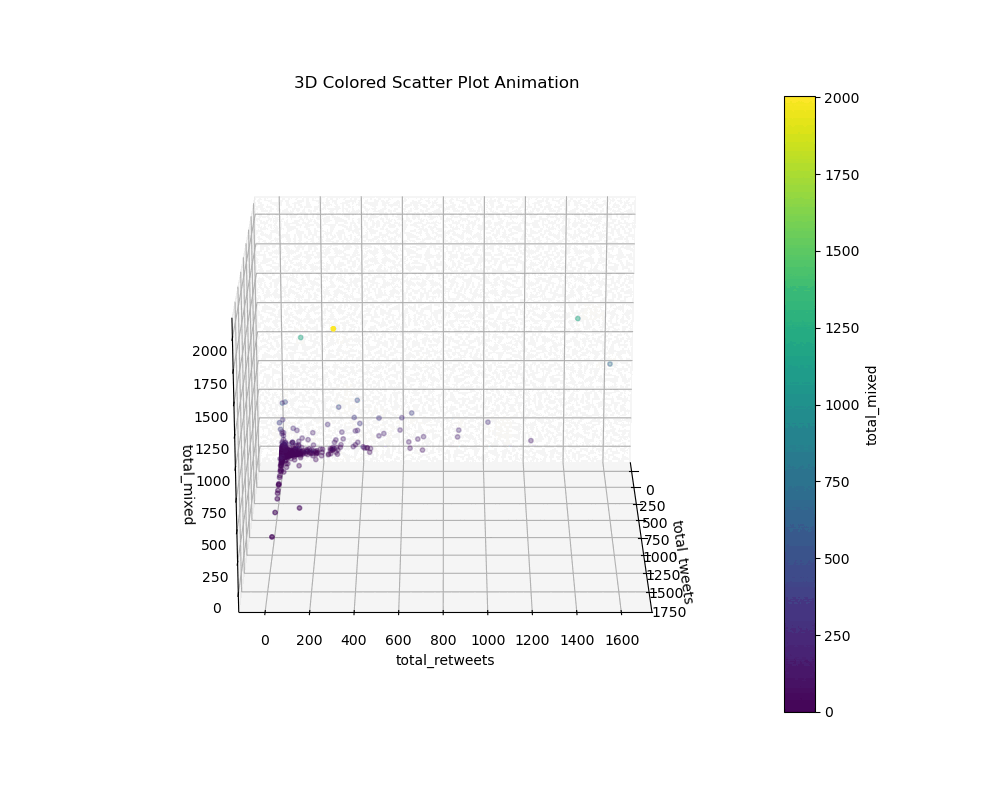

In [22]:
from IPython.display import Image
with open('rotation_animation_colored.gif','rb') as f:
    display(Image(data=f.read(), format='png'))